In [1]:
!nvidia-smi

Mon Jun 30 02:14:31 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   31C    P0             47W /  400W |       0MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [2]:
%pip install -Uqqq pip --progress-bar off
%pip install -qqq git+https://github.com/huggingface/diffusers.git@05e7a85 --progress-bar off
%pip install -qqq accelerate==1.8.1 --progress-bar off

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [32]:
from diffusers import FluxKontextPipeline
import torch
from PIL import Image
import numpy as np
import random

np.random.seed(42)

MAX_SEED = np.iinfo(np.int32).max

In [4]:
pipe = FluxKontextPipeline.from_pretrained(
    "black-forest-labs/FLUX.1-Kontext-dev", torch_dtype=torch.bfloat16
).to("cuda")

model_index.json:   0%|          | 0.00/688 [00:00<?, ?B/s]

Fetching 23 files:   0%|          | 0/23 [00:00<?, ?it/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.53G [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/486 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/741 [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/19.9k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/561 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/588 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/735 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

(…)pytorch_model-00001-of-00003.safetensors:   0%|          | 0.00/9.98G [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/20.8k [00:00<?, ?B/s]

(…)pytorch_model-00002-of-00003.safetensors:   0%|          | 0.00/9.95G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/452 [00:00<?, ?B/s]

(…)pytorch_model-00003-of-00003.safetensors:   0%|          | 0.00/3.87G [00:00<?, ?B/s]

(…)ion_pytorch_model.safetensors.index.json:   0%|          | 0.00/121k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/914 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/168M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

In [5]:
!nvidia-smi

Mon Jun 30 02:18:28 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   32C    P0             53W /  400W |   32625MiB /  40960MiB |     30%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [52]:
guidance_scale = 2.5
steps = 30

In [53]:
def generate_image(
    prompt: str,
    start_image: Image = None,
    guidance_scale: float = guidance_scale,
    steps: int = steps,
) -> Image:
    seed = random.randint(0, MAX_SEED)
    print(f"Seed: {seed}")
    if start_image:
        start_image = start_image.convert("RGB")
        return pipe(
            image=start_image,
            prompt=prompt,
            guidance_scale=guidance_scale,
            width=start_image.size[0],
            height=start_image.size[1],
            num_inference_steps=steps,
            generator=torch.Generator().manual_seed(seed),
        ).images[0]
    return pipe(
        prompt=prompt,
        guidance_scale=guidance_scale,
        num_inference_steps=steps,
        generator=torch.Generator().manual_seed(seed),
    ).images[0]

## Realism

In [86]:
%%time
prompt = """
Ultra-photorealistic action shot of a hypercar at night on the Monaco circuit.
Rain-slicked asphalt reflecting the neon city lights,
motion blur effect, dramatic lighting.
""".strip()
image = generate_image(prompt)

Seed: 73383889


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.5 s, sys: 3.76 s, total: 15.2 s
Wall time: 15.1 s


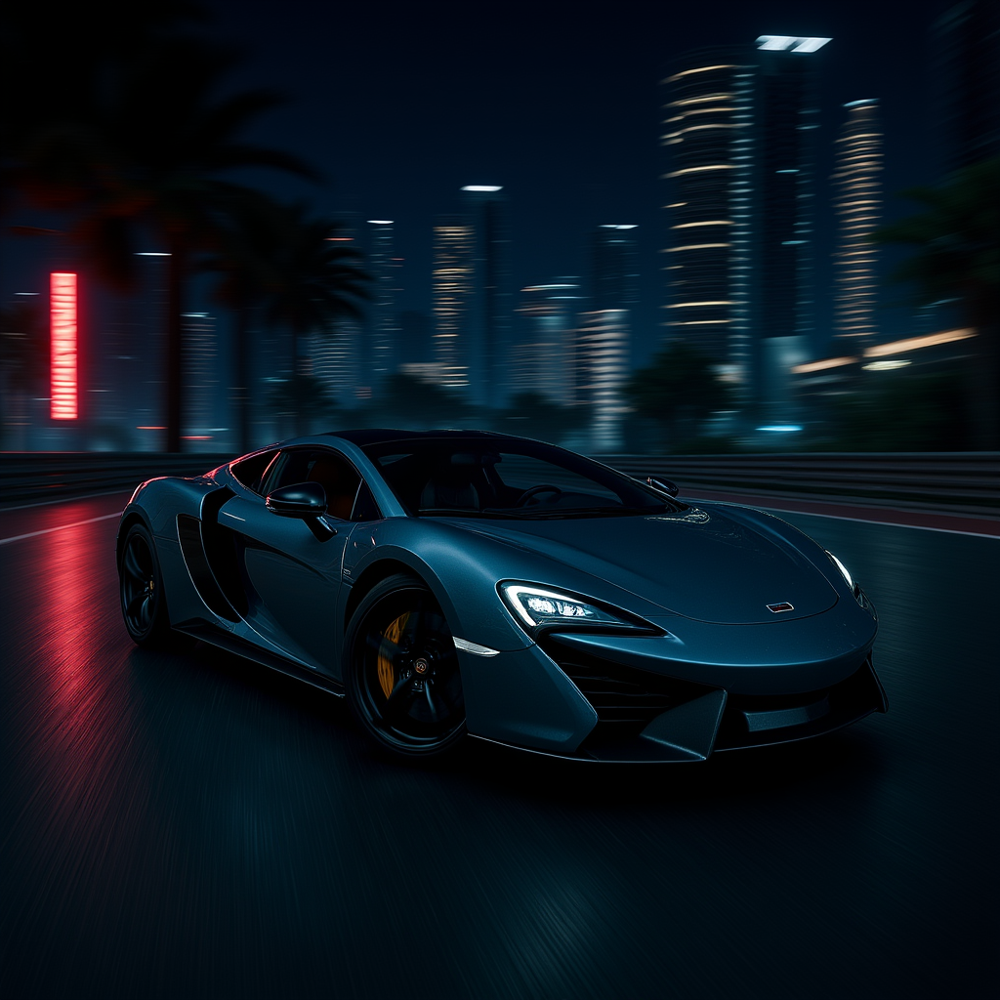

In [87]:
image

In [101]:
%%time
prompt = """
Ultra-photorealistic, low-angle frontal shot of a Koenigsegg Jesko Absolut
at full speed on the Bonneville Salt Flats. The car's exposed carbon fiber
body glistens under the harsh sun, kicking up a
dramatic plume of white salt. Heat haze shimmers off the asphalt.
Cinematic, sharp focus, 8K.
""".strip()
image = generate_image(prompt)

Seed: 1391399911


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.5 s, sys: 3.8 s, total: 15.3 s
Wall time: 15.2 s


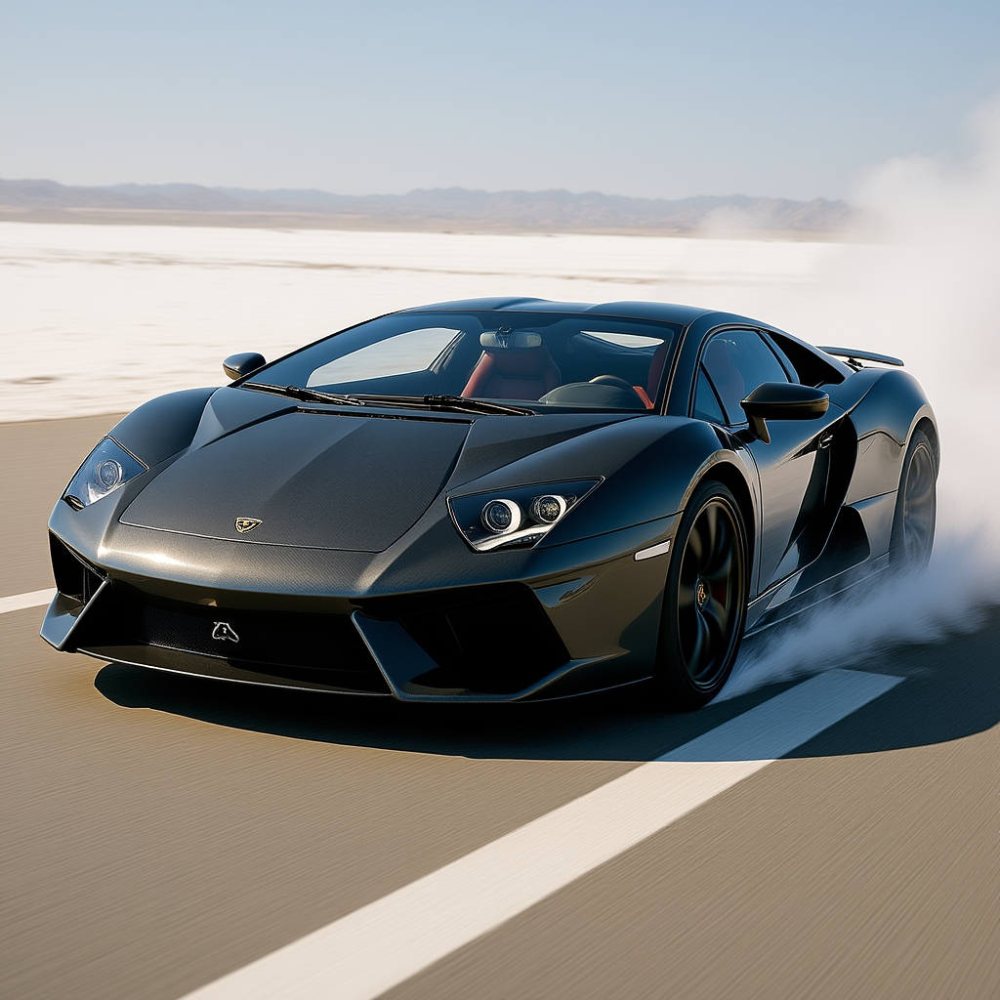

In [102]:
image

## Animated Characters

In [103]:
%%time
prompt = """
A whimsical digital painting of an impossibly fluffy baby Fennec fox,
curled up asleep on a giant, plush mushroom. Its fur is extra soft and
detailed, with giant, expressive, sparkling eyes (even while closed)
and a tiny pink nose. Soft, warm, magical forest lighting.
Style of Studio Ghibli, 4K, incredibly cute.
""".strip()
fox_image = generate_image(prompt)

Seed: 2008359807


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.7 s, sys: 3.67 s, total: 15.3 s
Wall time: 15.2 s


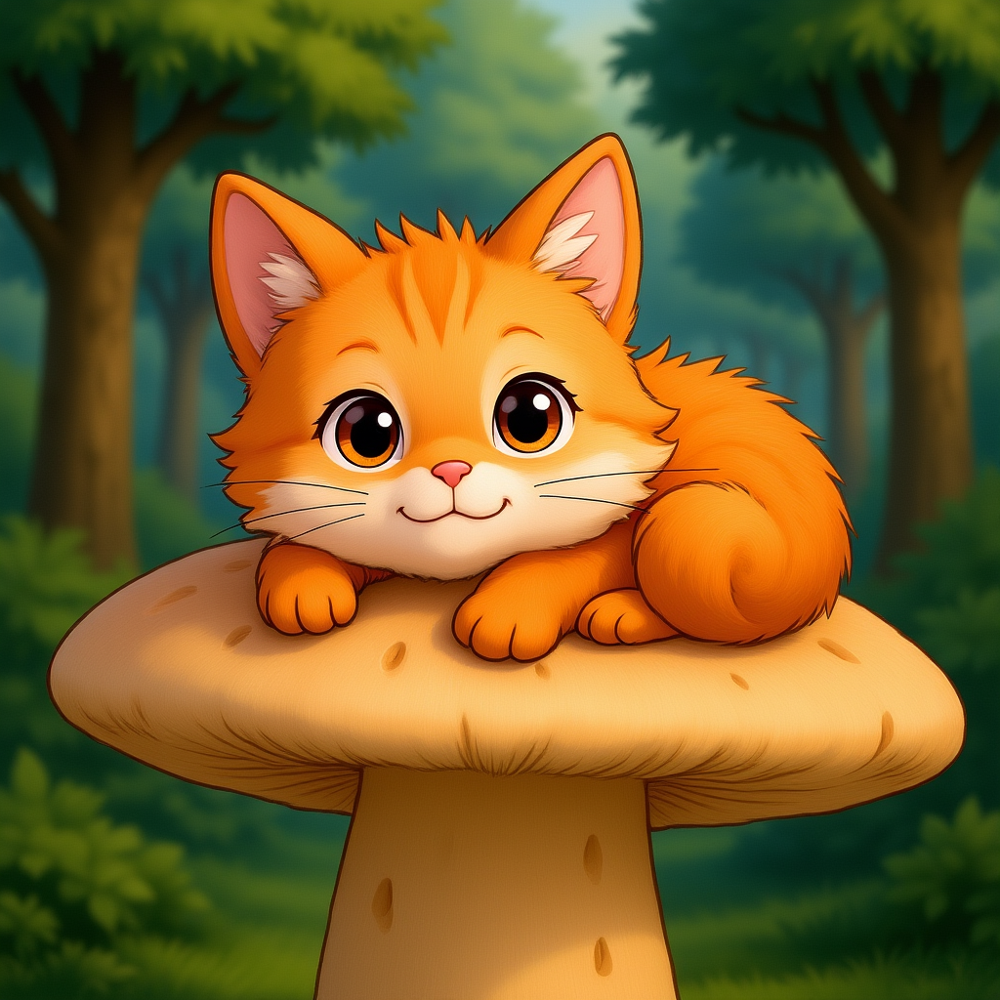

In [106]:
fox_image

In [109]:
%%time
prompt = """
Place the same impossibly fluffy baby Fennec fox on a worn wooden park bench
in the middle of a bustling modern city like New York.
The background shows towering glass skyscrapers and yellow cabs blurred in motion.
Dappled afternoon sunlight filters through the buildings, casting a soft glow on its fur.
Style of Studio Ghibli, 4K, incredibly cute.
""".strip()
image = generate_image(prompt, fox_image)

Seed: 683496541


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 23 s, sys: 9.38 s, total: 32.4 s
Wall time: 32.2 s


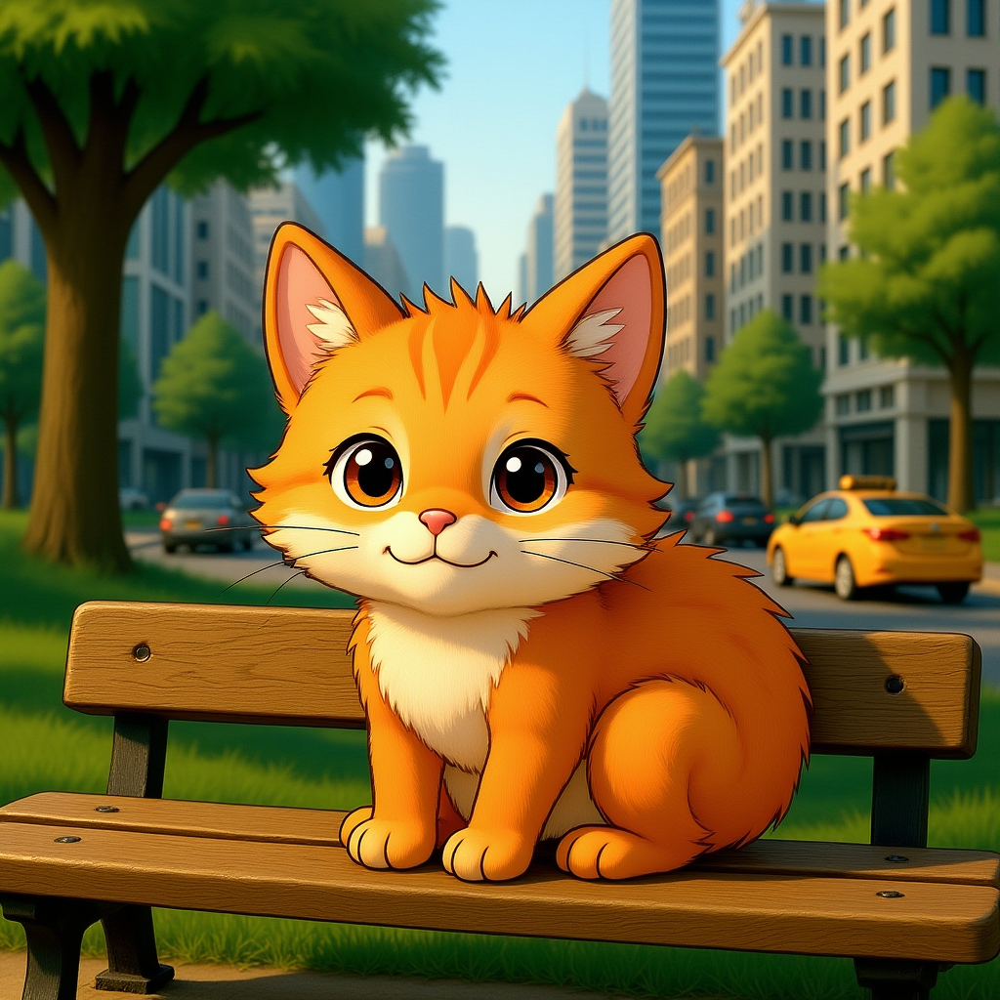

In [110]:
image

## Text

In [113]:
%%time
prompt = """
A retro-futuristic recruitment poster. In the center, a lone astronaut in a
sleek exosuit. Above, in bold, weathered typography,
the text reads: 'JOIN THE VOID-WALKERS'. Below, in smaller font:
'DEFEND THE FRONTI...ER'.
Style of 1970s science fiction art, distressed paper texture.
""".strip()
image = generate_image(prompt)

Seed: 1225028478


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.6 s, sys: 3.69 s, total: 15.3 s
Wall time: 15.2 s


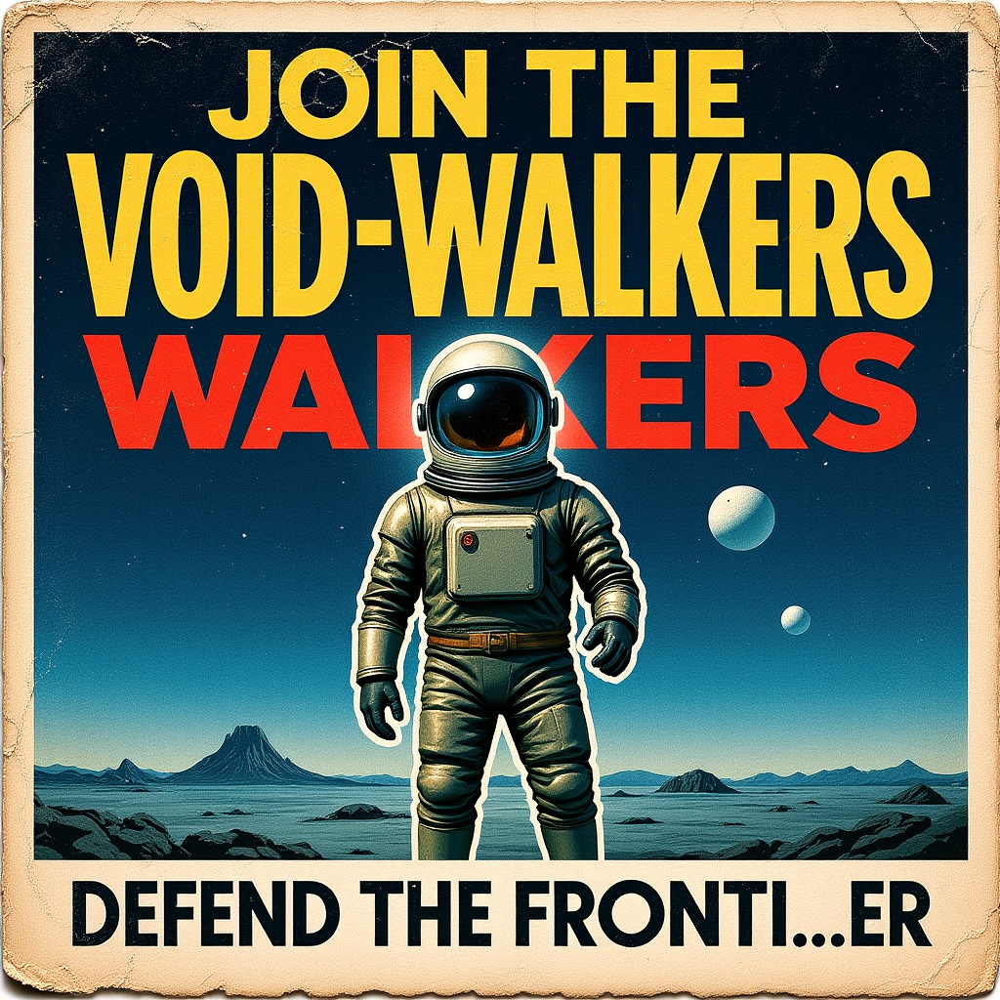

In [114]:
image

## Interior Design

In [115]:
%%time
prompt = """
Interior design shot of a minimalist Scandinavian living room.
Sunlight streaming through floor-to-ceiling windows, highlighting a plush white
boucle sofa and light oak floors. A large, textured abstract painting
hangs on the wall.
Photorealistic, 8K, wide-angle shot, interior design magazine quality.
""".strip()
image = generate_image(prompt)

Seed: 1380755949


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.5 s, sys: 3.73 s, total: 15.2 s
Wall time: 15.1 s


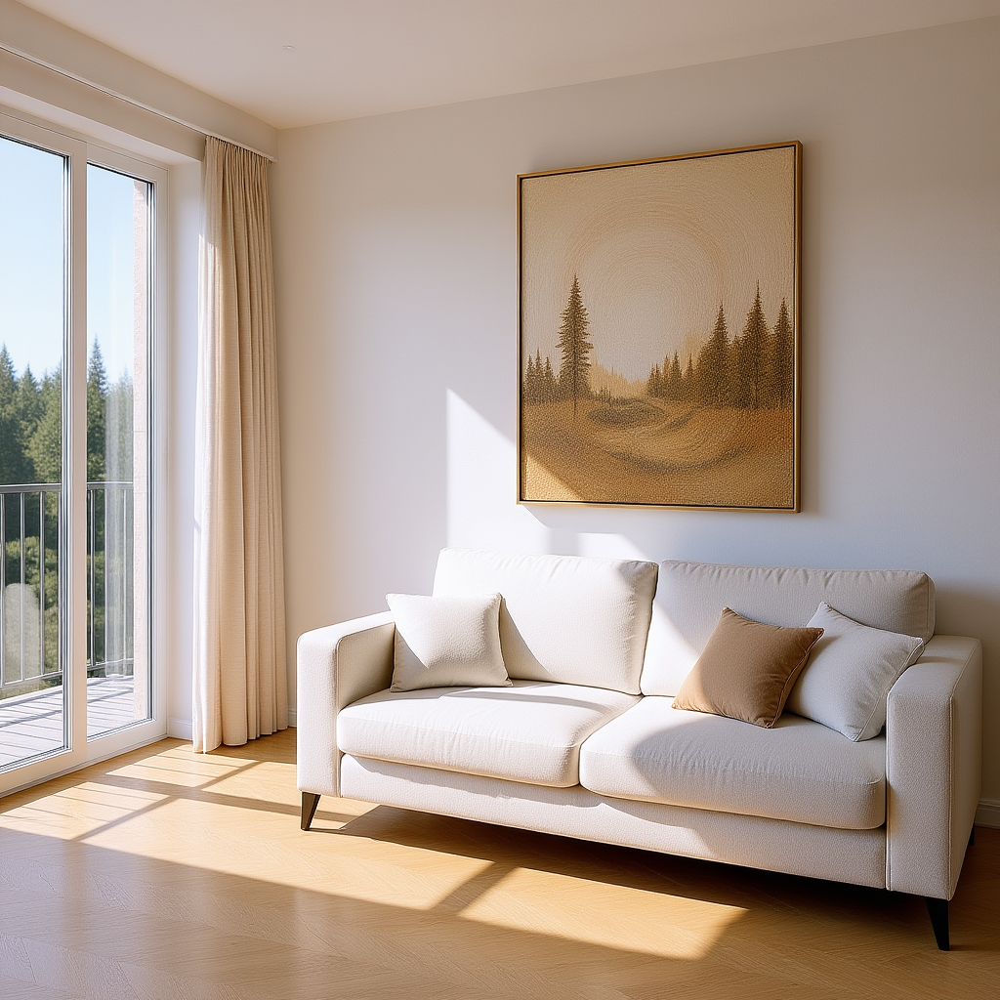

In [116]:
image

In [120]:
%%time
prompt = """
Photorealistic rendering of a Japandi-style kitchen. Matte black,
floor-to-ceiling cabinetry, a massive quartzite waterfall island, and brushed
brass fixtures. Warm, integrated LED lighting.
A large picture window overlooks a serene garden.
Impeccably clean, architectural digest style, 8K.
""".strip()
image = generate_image(prompt)

Seed: 354495499


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.4 s, sys: 3.78 s, total: 15.2 s
Wall time: 15.1 s


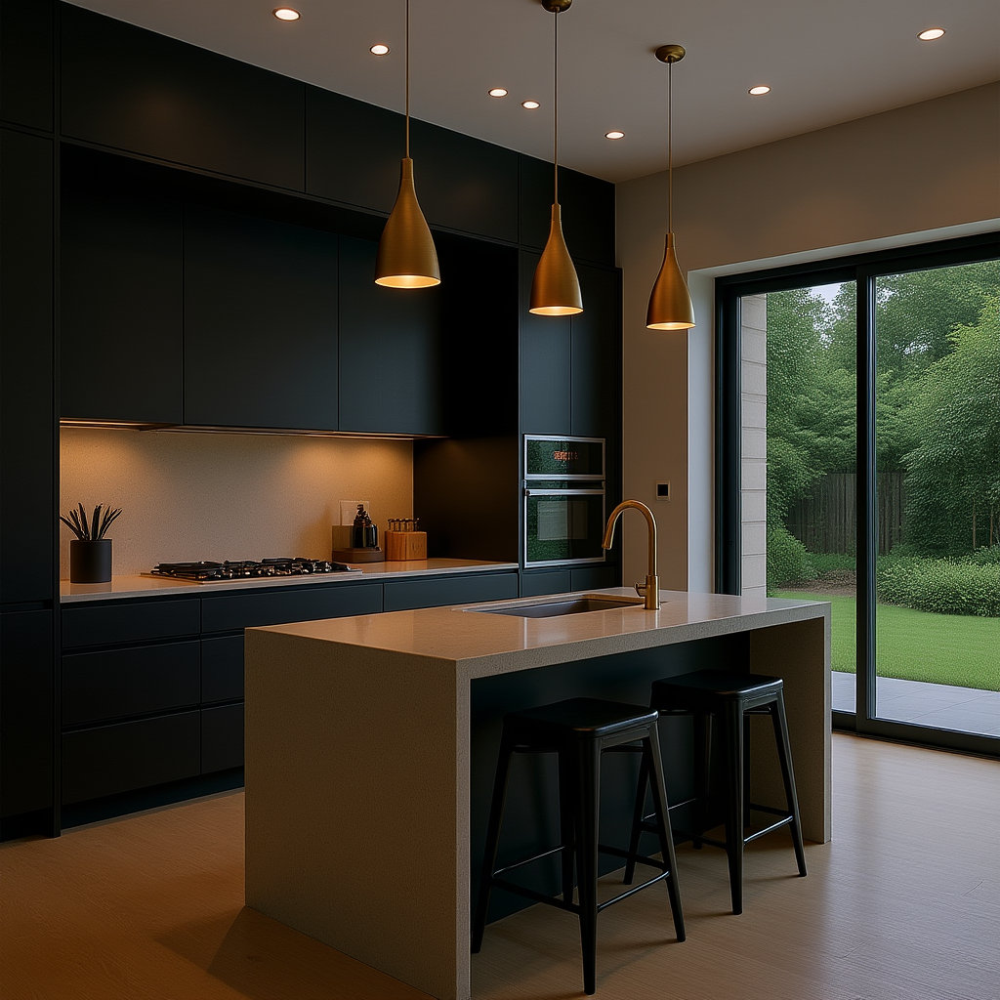

In [121]:
image

## Architecture

In [158]:
%%time
prompt = """
Architectural photography of a luxury beach villa. Cantilevered concrete levels
perched on a cliff overlooking the ocean at sunset. An infinity pool seamlessly
merges with the horizon. Expansive floor-to-ceiling glass walls reveal a
minimalist interior with a warm glow.
Dramatic shadows, award-winning design, ultra-realistic, 8K.
""".strip()
image = generate_image(prompt)

Seed: 827640133


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.4 s, sys: 3.76 s, total: 15.2 s
Wall time: 15.1 s


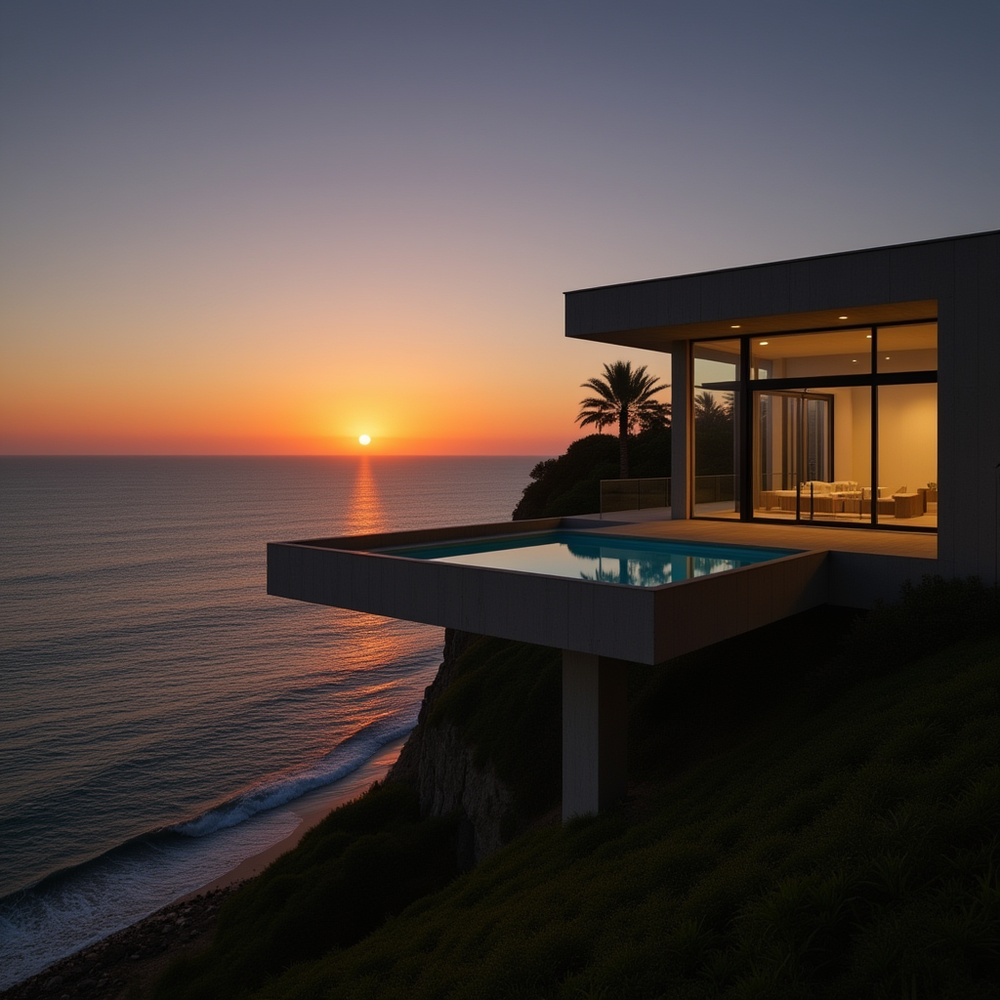

In [159]:
image

In [130]:
%%time
prompt = """
A stunning modernist house with Japanese wabi-sabi influence,
nestled in a dense, misty pine forest. Constructed from charred wood
(Shou Sugi Ban) and board-formed concrete, with expansive glass panels.
Captured during early morning light.
Architectural photography, ultra-photorealistic, 8K.
""".strip()
image = generate_image(prompt)

Seed: 952221543


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.5 s, sys: 3.76 s, total: 15.3 s
Wall time: 15.2 s


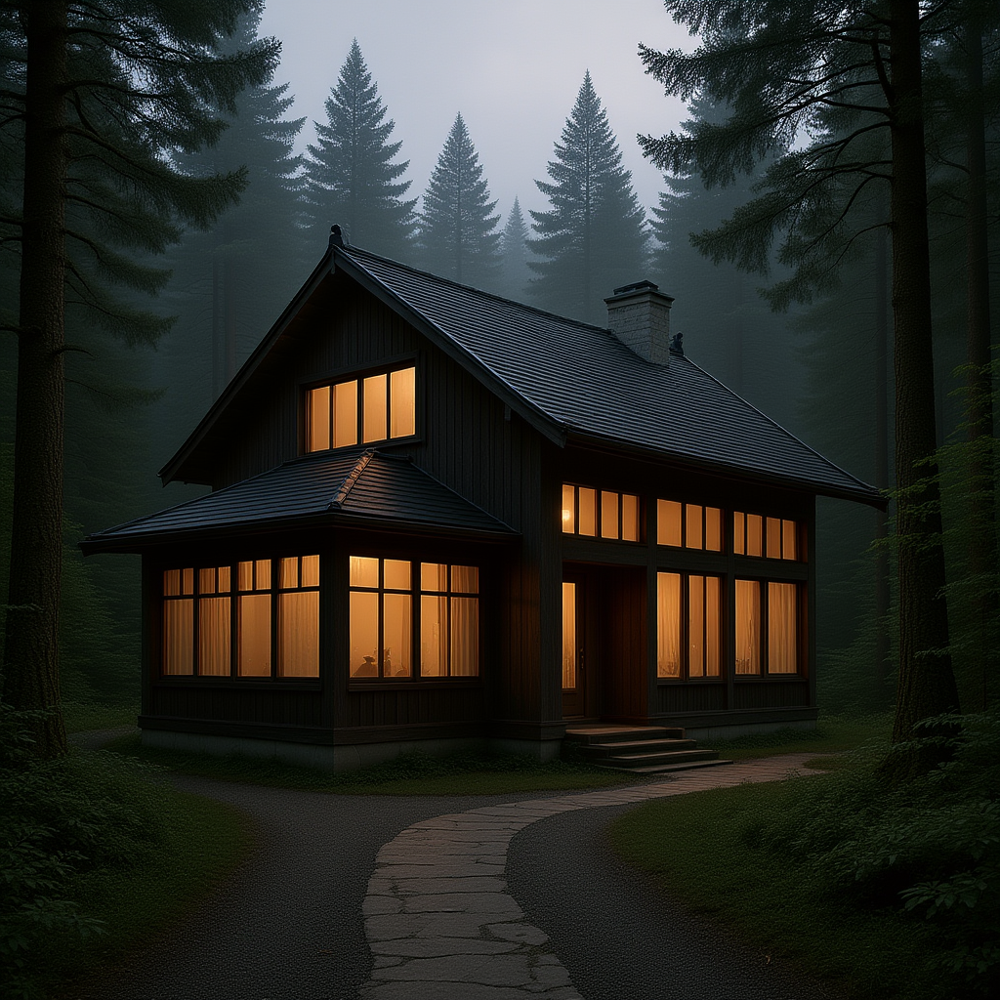

In [131]:
image

## Photo Editing

In [ ]:
%%time
prompt = """
Ultra-photorealistic cinematic portrait of a gorgeous brunette woman leaning against her sport motorcycle.
Her smoldering eyes lock with the camera, a hint of a smirk on her lips.
Wearing a tight black leather jacket and dark jeans.
Dramatic golden hour light. Shallow depth of field, 8K.
""".strip()
moto_woman = generate_image(prompt)

Seed: 383351053


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 11.4 s, sys: 3.78 s, total: 15.2 s
Wall time: 15.1 s


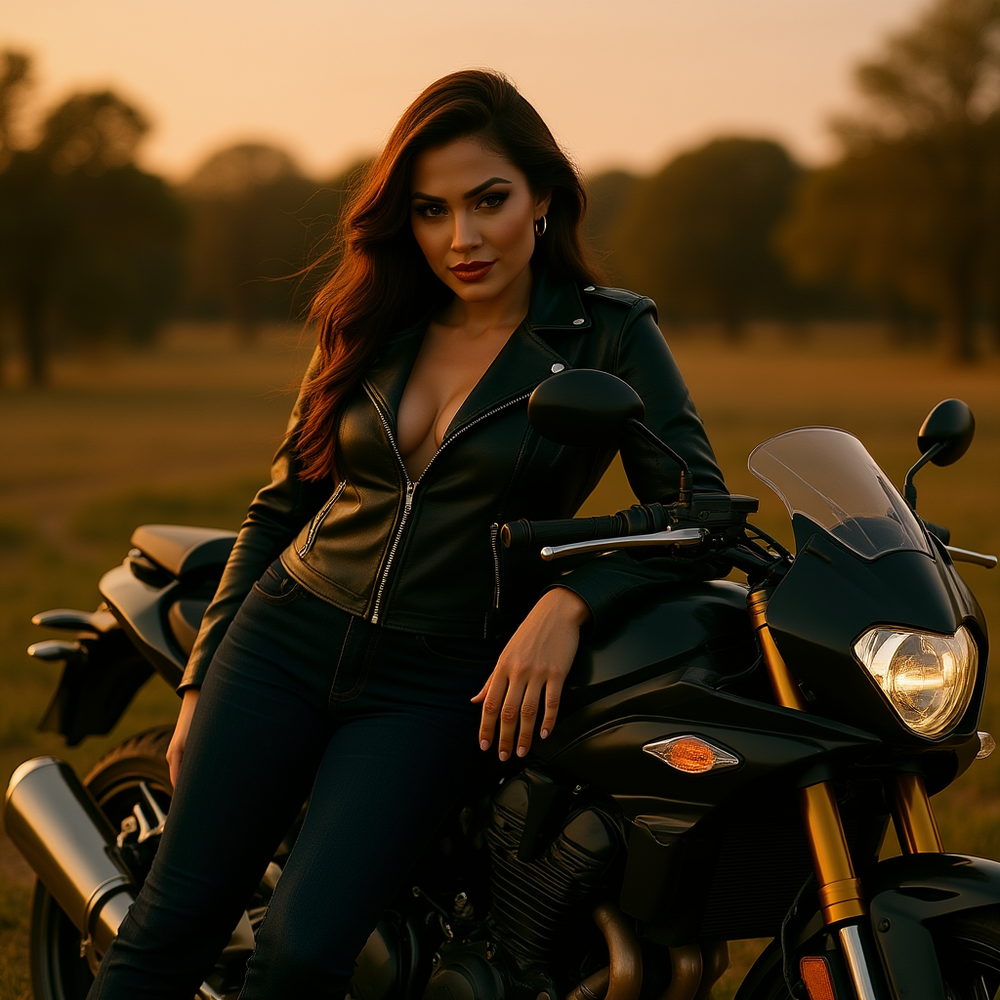

In [ ]:
moto_woman

In [ ]:
%%time
prompt = """
Keep the same woman, but place her in a luxury penthouse apartment overlooking a rain-slicked, metropolis at night.
Change her outfit to a sleek, elegant black cocktail dress.
She now stands by the floor-to-ceiling window, looking over her shoulder at the camera.
""".strip()
image = generate_image(prompt, start_image=moto_woman)

Seed: 1413507135


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 23 s, sys: 9.36 s, total: 32.4 s
Wall time: 32.2 s


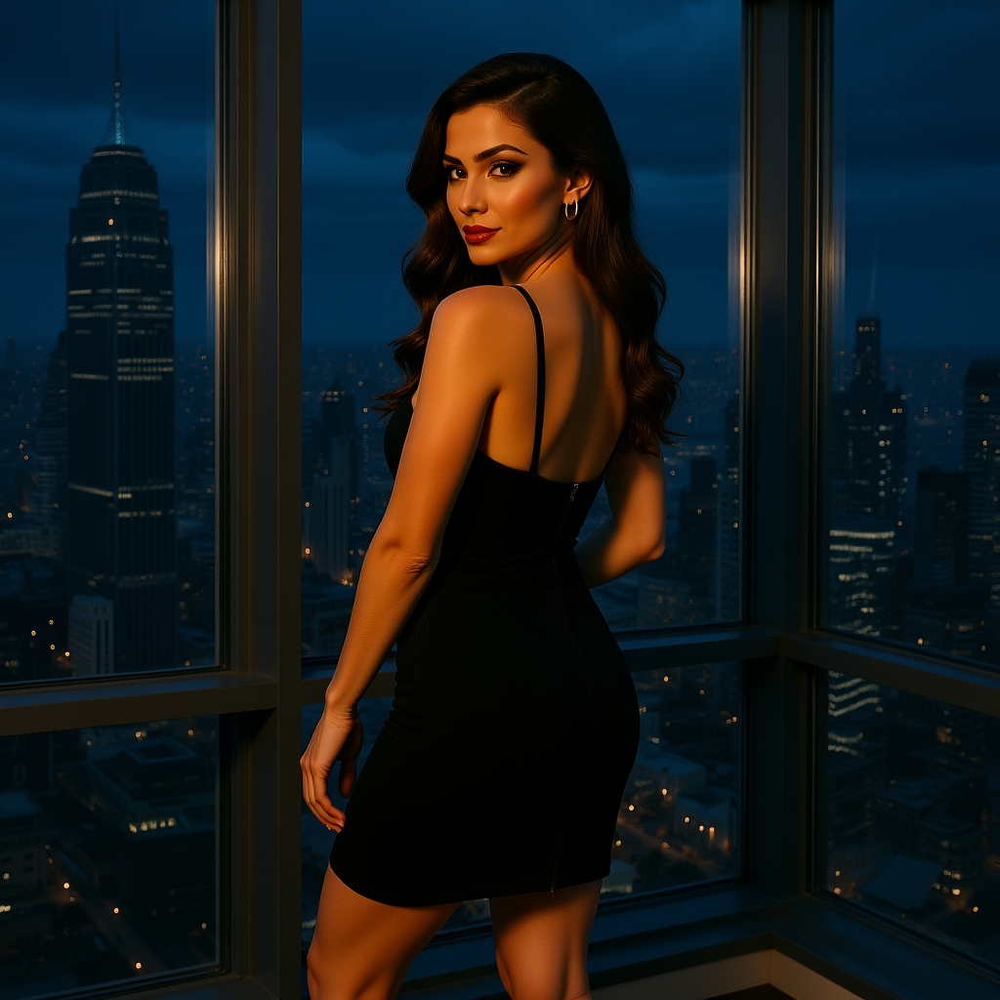

In [ ]:
image

In [ ]:
%%time
prompt = """
Keep the same woman. Place her at a high-stakes poker table in an exclusive,
dimly lit Monaco casino. Change her attire to a stunning,
form-fitting scarlet red evening gown. She's holding a winning hand of cards,
with a subtle, knowing smile. Shallow depth of field.
""".strip()
image = generate_image(prompt, start_image=moto_woman)

Seed: 1616224039


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 23.2 s, sys: 9.2 s, total: 32.4 s
Wall time: 32.2 s


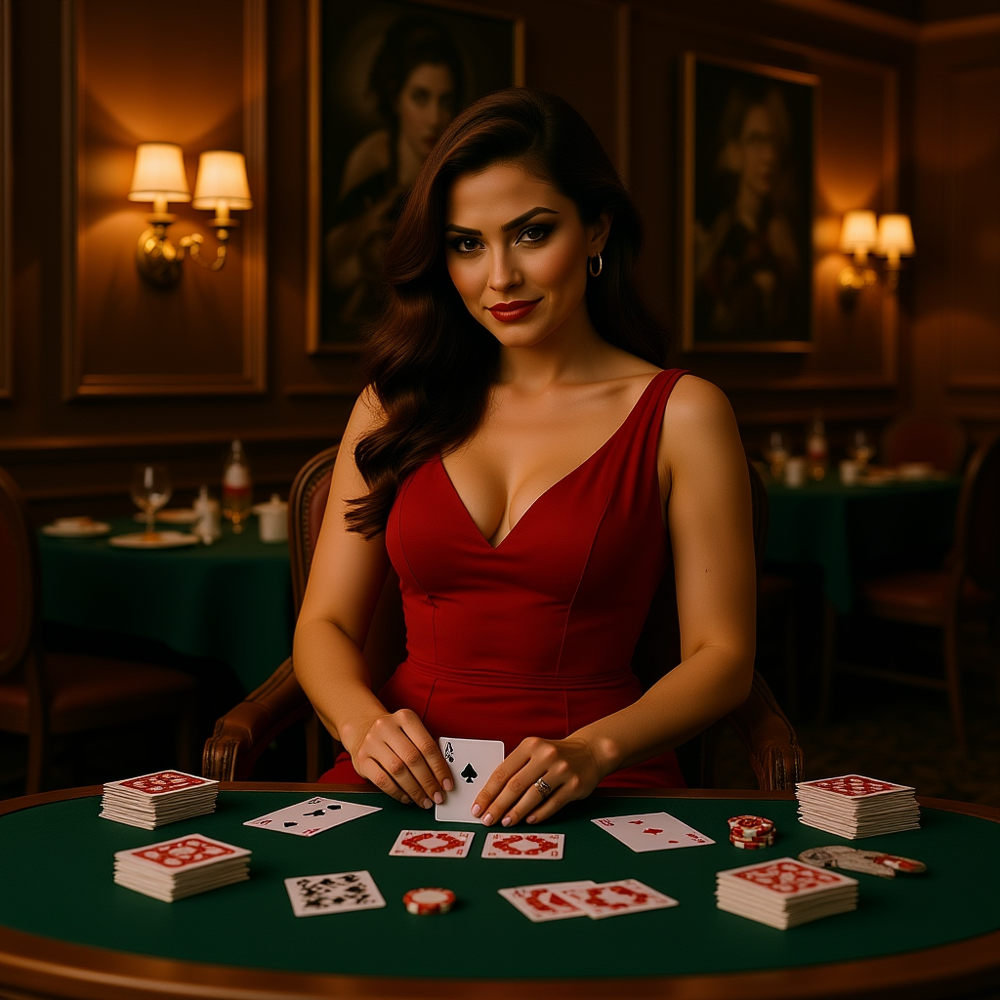

In [ ]:
image

In [ ]:
%%time
prompt = """
Ultra-photorealistic beauty advertisement. Photo studio background.
The same woman in white dress, now in her late 30s, exuding confidence with radiant, flawless skin.
She has a serene, gentle smile.Soft studio lighting highlights her
features as she lightly touches her jawline.
Minimalist, out-of-focus background. 8K, sharp focus.
""".strip()
image = generate_image(prompt, start_image=moto_woman)

Seed: 1896912735


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 23 s, sys: 9.54 s, total: 32.5 s
Wall time: 32.3 s


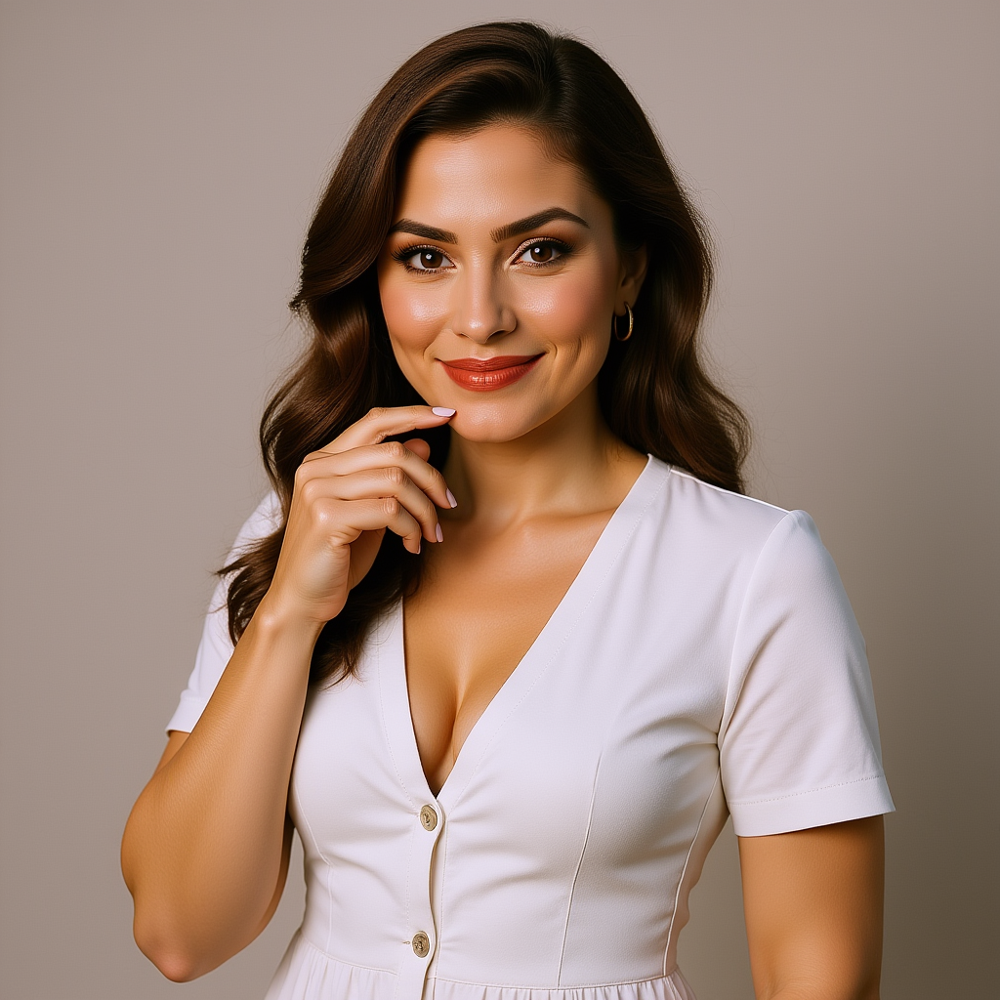

In [ ]:
image

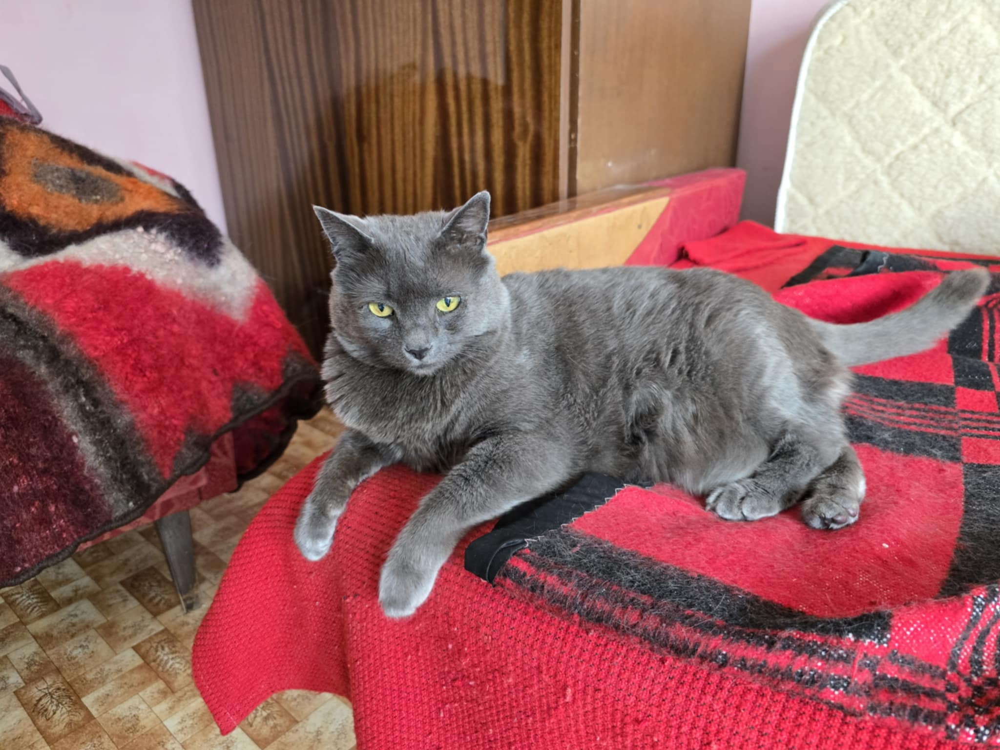

In [160]:
cat = Image.open("cat.jpeg")
cat

In [174]:
%%time
prompt = """
Ultra-photorealistic scene. Keep the same female cat.
Put the cat in front of a kebab shop waiting for her kebab portion.
Minimalist, out-of-focus background. 8K, sharp focus.
""".strip()
image = generate_image(prompt, start_image=cat)

Generation `height` and `width` have been adjusted to 880 and 1168 to fit the model requirements.


Seed: 623025825


  0%|          | 0/30 [00:00<?, ?it/s]

CPU times: user 22.9 s, sys: 9.17 s, total: 32.1 s
Wall time: 31.9 s


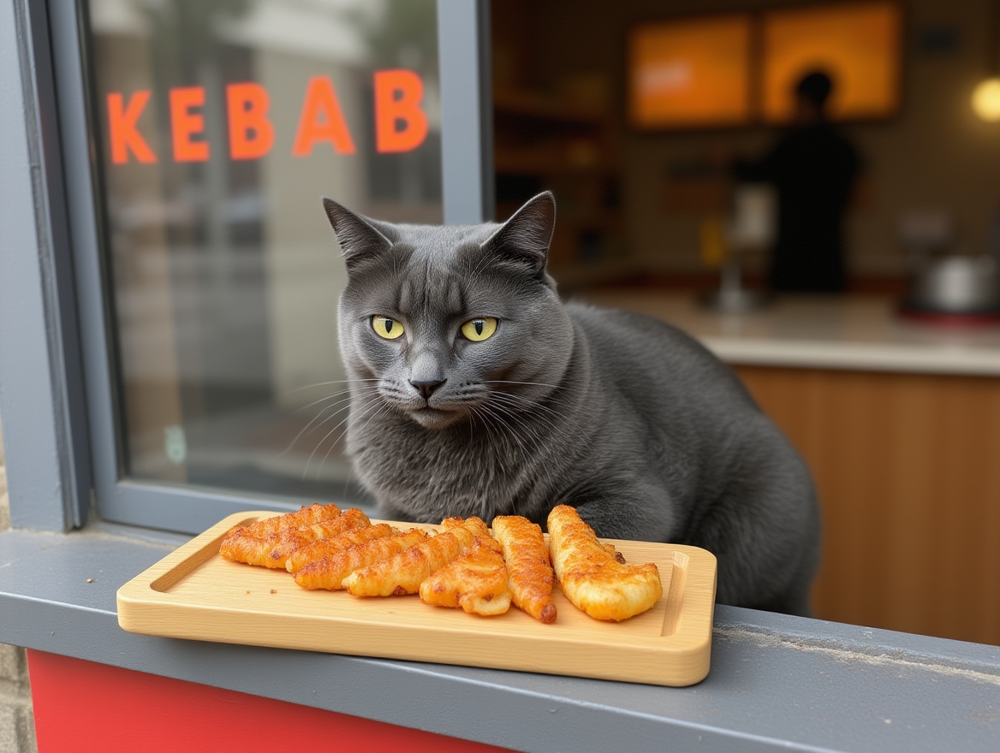

In [175]:
image